In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [3]:
import os

In [4]:
os.listdir(r"C:\Users\Piyush\Desktop\oytie\Uber Analysis\Datasets")

['other-American_B01362.csv',
 'other-Carmel_B00256.csv',
 'other-Dial7_B00887.csv',
 'other-Diplo_B01196.csv',
 'other-Federal_02216.csv',
 'other-FHV-services_jan-aug-2015.csv',
 'other-Firstclass_B01536.csv',
 'other-Highclass_B01717.csv',
 'other-Lyft_B02510.csv',
 'other-Prestige_B01338.csv',
 'other-Skyline_B00111.csv',
 'Uber-Jan-Feb-FOIL.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [5]:
files = os.listdir(r"C:\Users\Piyush\Desktop\oytie\Uber Analysis\Datasets")[-8:]

In [6]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-janjune-15_sample.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [7]:
files.remove('uber-raw-data-janjune-15_sample.csv')
files.remove('uber-raw-data-janjune-15.csv')

In [8]:
files

['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [9]:
final = pd.DataFrame()

path = r"C:\Users\Piyush\Desktop\oytie\Uber Analysis\Datasets"

for file in files :
    current_df = pd.read_csv(path+'/'+file)
    final = pd.concat([current_df , final])

In [10]:
final.shape

(4534327, 4)

In [11]:
df = final.copy()

In [12]:
df.head()

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512


In [13]:
df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [14]:
df['Date/Time'] = pd.to_datetime(df['Date/Time'], format='%m/%d/%Y %H:%M:%S')

In [15]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [16]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512


In [17]:
df['weekday']=df['Date/Time'].dt.day_name()

In [18]:
df['day']=df['Date/Time'].dt.day

In [19]:
df['minute']=df['Date/Time'].dt.minute
df['month']=df['Date/Time'].dt.month
df['hour']=df['Date/Time'].dt.hour

In [20]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,9,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,9,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,9,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,9,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,9,0


In [21]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
weekday              object
day                   int32
minute                int32
month                 int32
hour                  int32
dtype: object

In [22]:
df['weekday'].value_counts().index

Index(['Thursday', 'Friday', 'Wednesday', 'Tuesday', 'Saturday', 'Monday',
       'Sunday'],
      dtype='object', name='weekday')

In [12]:
import plotly.express as px

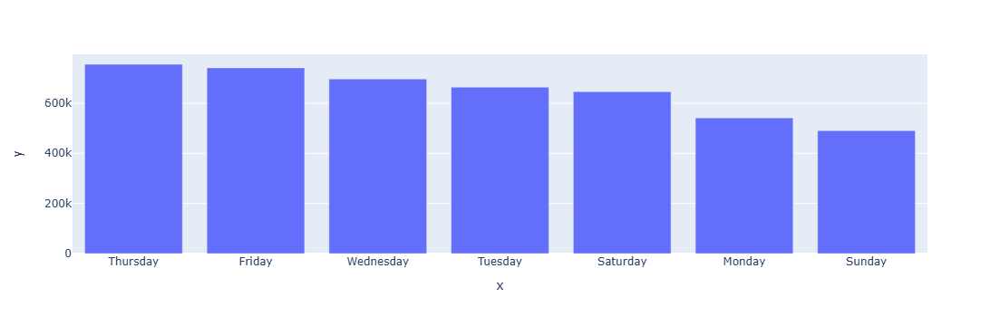

In [24]:
px.bar(x=df['weekday'].value_counts().index, y=df['weekday'].value_counts())

(array([216928., 103517., 227152., 543565., 324851., 366329., 819491.,
        660869., 579117., 692508.]),
 array([ 0. ,  2.3,  4.6,  6.9,  9.2, 11.5, 13.8, 16.1, 18.4, 20.7, 23. ]),
 <BarContainer object of 10 artists>)

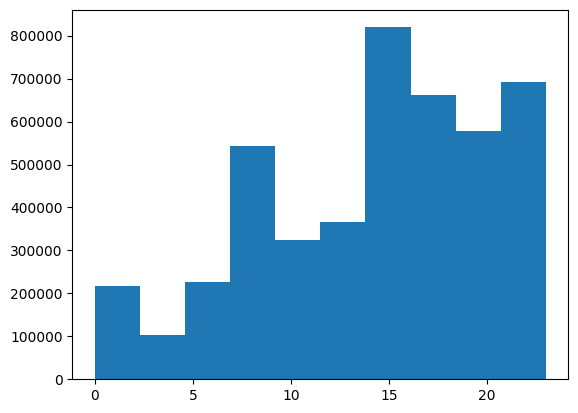

In [25]:
plt.hist(df['hour'])

In [26]:
df['month'].unique()

array([9, 5, 6, 7, 8, 4])

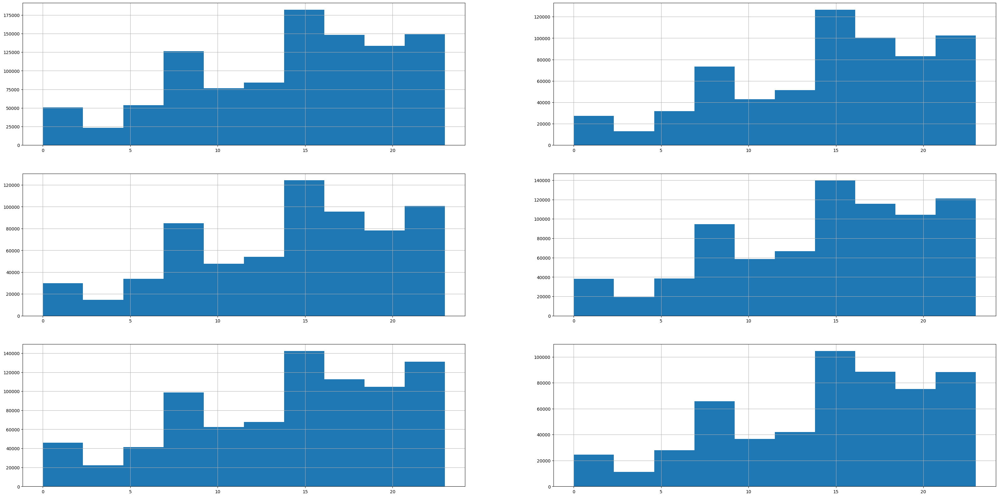

In [27]:
plt.figure(figsize=(40,20))
for i,month in enumerate(df['month'].unique()):
    plt.subplot(3,2,i+1)
    df[df['month']==month]['hour'].hist()

In [28]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,9,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,9,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,9,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,9,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,9,0


In [29]:
import chart_studio.plotly as py
import plotly.graph_objects as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [30]:
import chart_studio.plotly as py
import plotly.graph_objects as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [31]:
df.groupby('month')['hour'].count()

month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: hour, dtype: int64

In [32]:
trace1=go.Bar(x=df.groupby('month')['hour'].count().index,y=df.groupby('month')['hour'].count(),name='Priority')

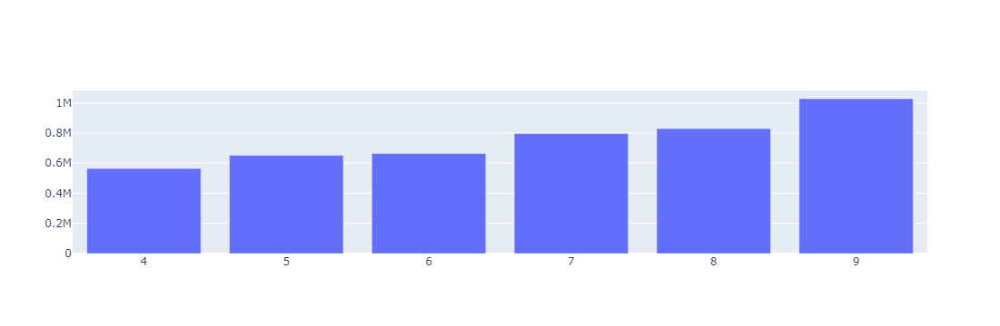

In [33]:
iplot([trace1])

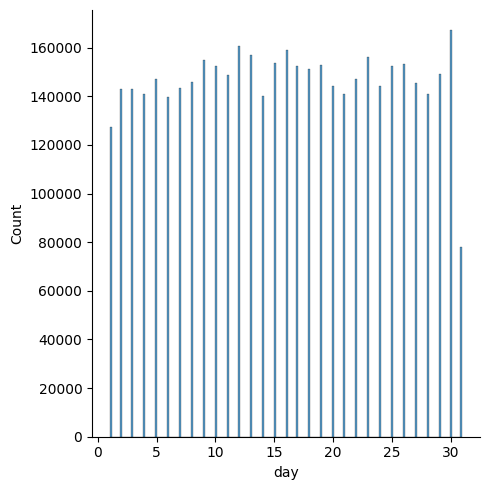

In [34]:
sns.displot(df['day'])

Text(0.5, 1.0, 'Journeys by month day')

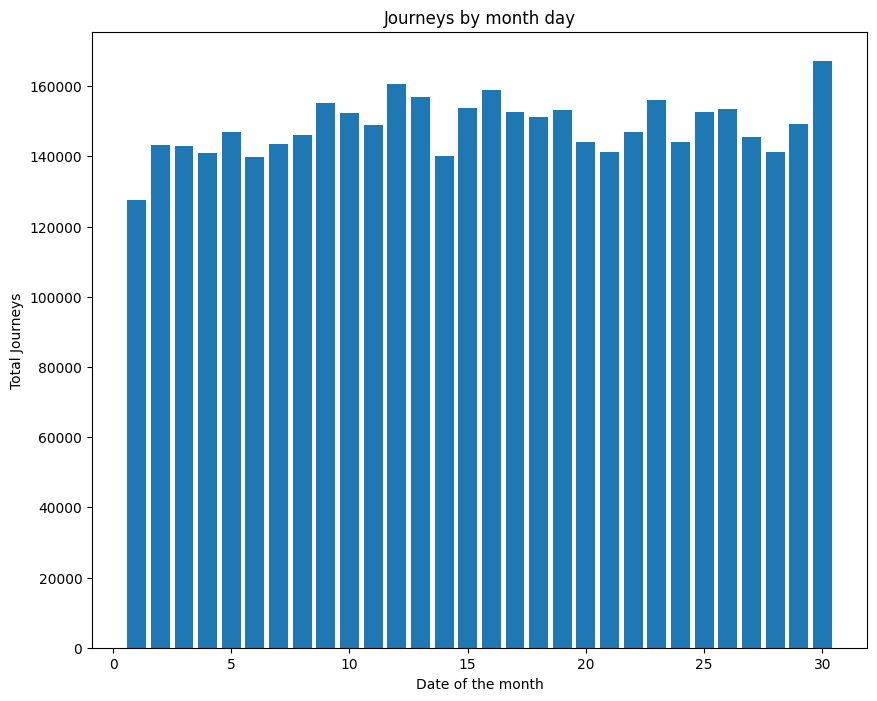

In [35]:
plt.figure(figsize=(10,8))
plt.hist(df['day'], bins=30,rwidth=0.8,range=(0.5,30.5))
plt.xlabel('Date of the month')
plt.ylabel('Total Journeys')
plt.title('Journeys by month day')

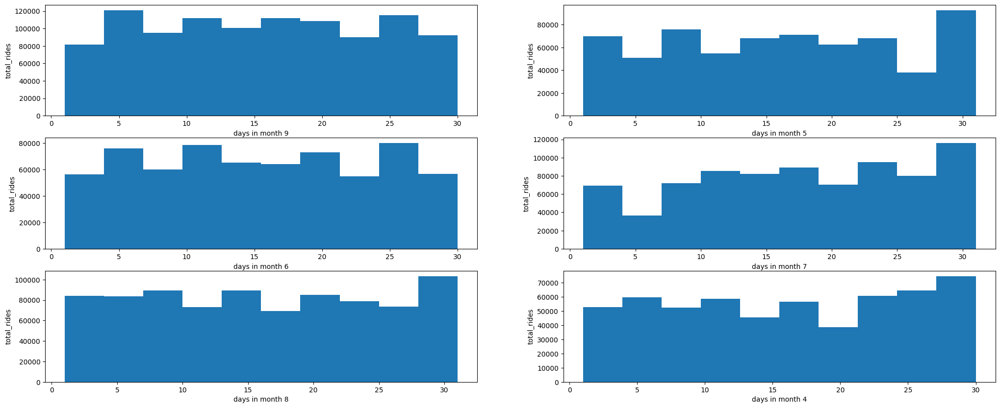

In [36]:
plt.figure(figsize=(25,10))
for i, month in enumerate(df['month'].unique(),1):
    plt.subplot(3,2,i)
    df_out=df[df['month']==month]
    plt.hist(df_out['day'])
    plt.xlabel('days in month {}'.format(month) )
    plt.ylabel('total_rides')

Text(0.5, 1.0, 'houroffday vs latitude of passenger')

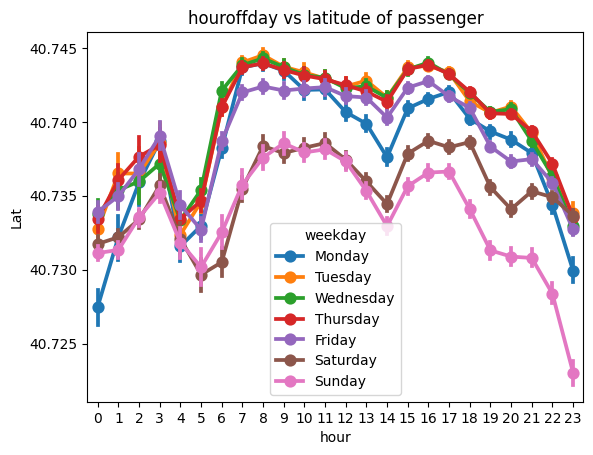

In [37]:
ax=sns.pointplot(x='hour',y='Lat',data=df,hue='weekday')
ax.set_title('houroffday vs latitude of passenger')

In [38]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
0,2014-09-01 00:01:00,40.2201,-74.0021,B02512,Monday,1,1,9,0
1,2014-09-01 00:01:00,40.7500,-74.0027,B02512,Monday,1,1,9,0
2,2014-09-01 00:03:00,40.7559,-73.9864,B02512,Monday,1,3,9,0
3,2014-09-01 00:06:00,40.7450,-73.9889,B02512,Monday,1,6,9,0
4,2014-09-01 00:11:00,40.8145,-73.9444,B02512,Monday,1,11,9,0


In [39]:
base = df.groupby(['Base', 'month'])['Date/Time'].count().reset_index()
base

,Base,month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


<Axes: xlabel='month', ylabel='Date/Time'>

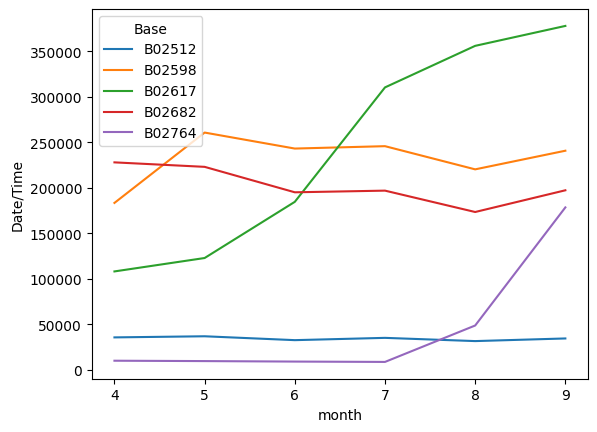

In [40]:
plt.figure(figure=(10,6))
sns.lineplot(x='month',y='Date/Time',hue='Base',data=base)

In [41]:
def count_rows(rows):
    return len(rows)

In [42]:
by_cross=df.groupby(['weekday','hour']).apply(count_rows)
by_cross

weekday    hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [43]:
pivot=by_cross.unstack()
pivot 

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


<Axes: xlabel='hour', ylabel='weekday'>

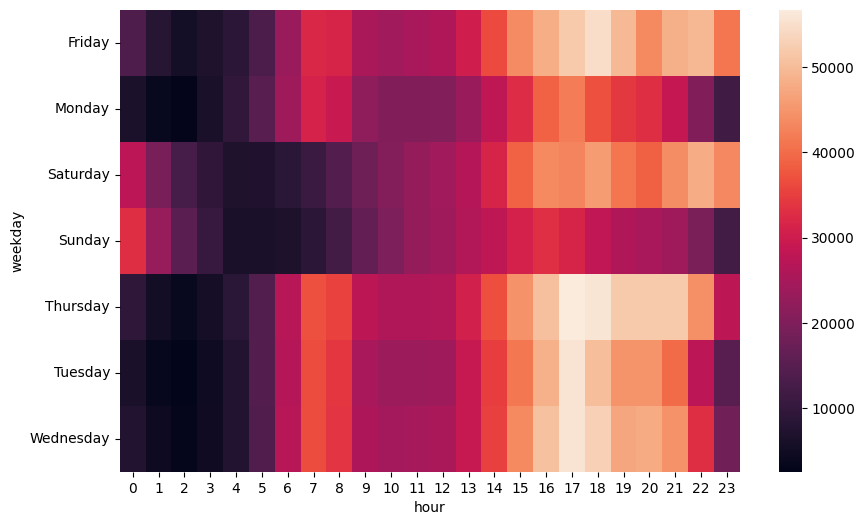

In [44]:
plt.figure(figsize=(10,6))
sns.heatmap(pivot)

In [45]:
def heatmap(col1,col2):
    by_cross=df.groupby([col1,col2]).apply(count_rows)
    pivot=by_cross.unstack()
    plt.figure(figsize=(10,6))
    return sns.heatmap(pivot)

<Axes: xlabel='hour', ylabel='day'>

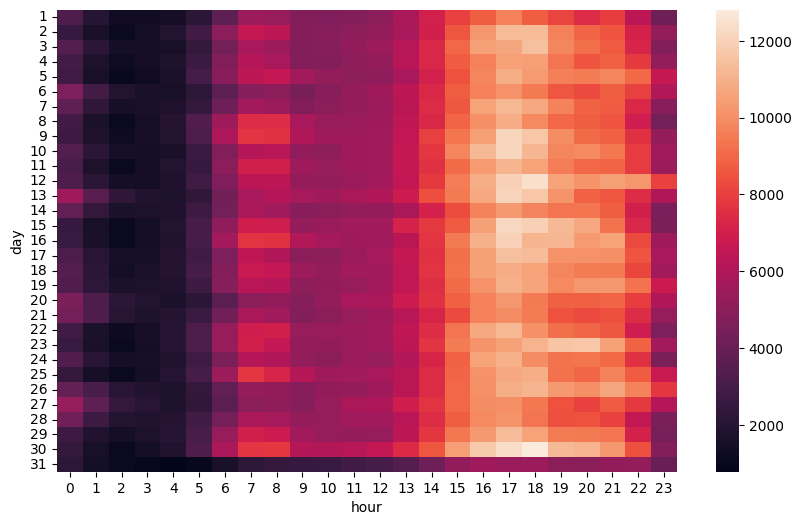

In [46]:
heatmap('day','hour')

<Axes: xlabel='day', ylabel='month'>

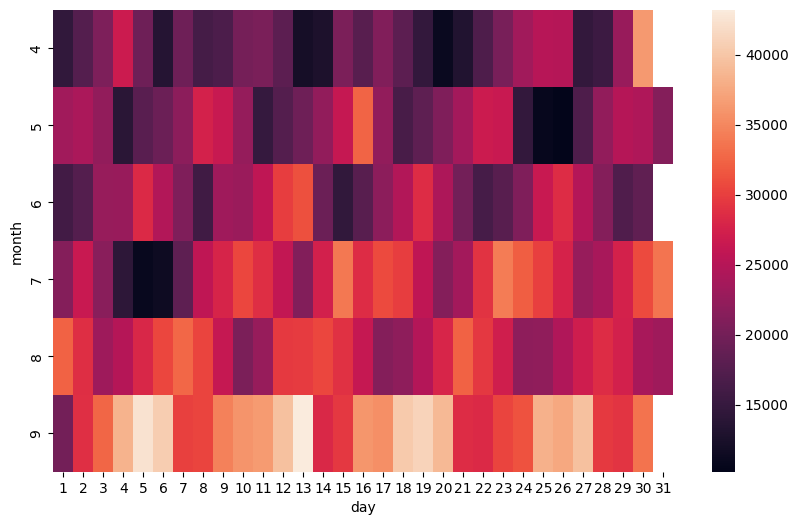

In [47]:
heatmap('month','day')

<Axes: xlabel='weekday', ylabel='month'>

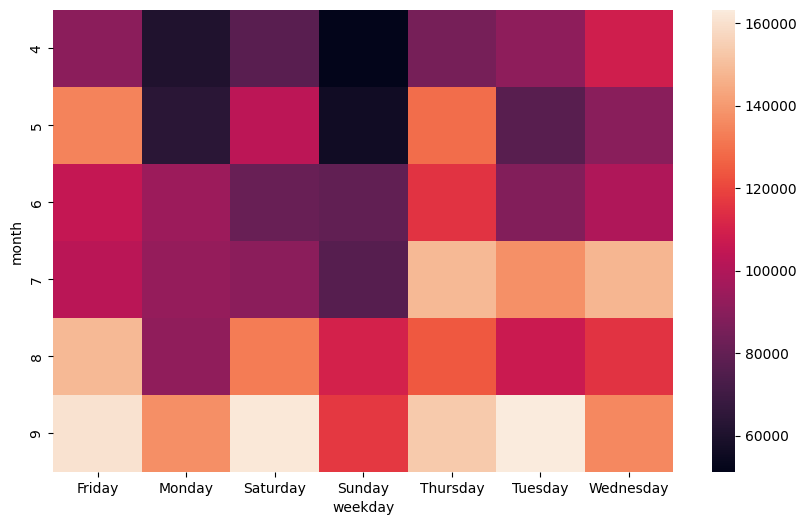

In [48]:
heatmap('month','weekday')

(40.6, 41.0)

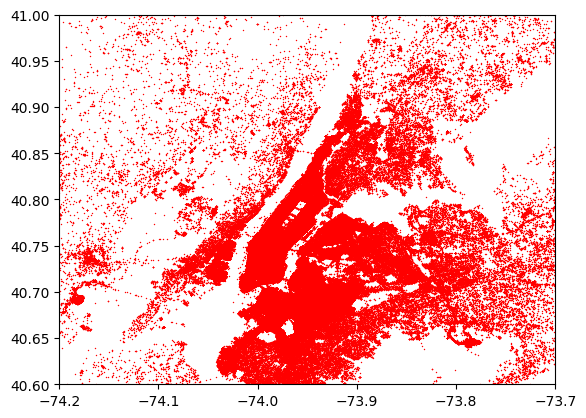

In [49]:
plt.plot(df['Lon'],df['Lat'],'r+',ms=0.5)
plt.xlim(-74.2,-73.7)
plt.ylim(40.6,41)

In [50]:
df_out=df[df['weekday']=='Sunday']

In [51]:
df_out.shape

(490180, 9)

In [52]:
df_out.head()

,Date/Time,Lat,Lon,Base,weekday,day,minute,month,hour
8011,2014-09-07 00:00:00,40.7341,-74.0005,B02512,Sunday,7,0,9,0
8012,2014-09-07 00:00:00,40.7344,-73.9900,B02512,Sunday,7,0,9,0
8013,2014-09-07 00:00:00,40.7806,-73.9582,B02512,Sunday,7,0,9,0
8014,2014-09-07 00:01:00,40.7293,-73.9859,B02512,Sunday,7,1,9,0
8015,2014-09-07 00:01:00,40.7713,-74.0133,B02512,Sunday,7,1,9,0


In [53]:
rush=df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index()

In [54]:
rush.columns=['Lat','Lon','no of trips']

In [55]:
rush

,Lat,Lon,no of trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1
...,...,...,...
209225,41.3141,-74.1249,1
209226,41.3180,-74.1298,1
209227,41.3195,-73.6905,1
209228,41.3197,-73.6903,1


In [56]:
from folium.plugins import HeatMap

In [57]:
import folium

In [58]:
basemap=folium.Map()

In [59]:
HeatMap(rush,zoom=20,radius=15).add_to(basemap)
basemap

In [60]:
def plot(df,day):
    df_out=df[df['weekday']==day]
    HeatMap(df_out.groupby(['Lat','Lon'])['weekday'].count().reset_index(),zoom=15,radius=15).add_to(basemap)
    return basemap

In [61]:
plot(df,'Saturday')

In [4]:
uber_15=pd.read_csv(r'C:\Users\Piyush\Desktop\oytie\Uber Analysis\Datasets/uber-raw-data-janjune-15.csv')

In [5]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [6]:
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [7]:
uber_15['Pickup_date'] = pd.to_datetime(uber_15['Pickup_date'], format='%Y-%m-%d %H:%M:%S')

In [8]:
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [9]:
uber_15['weekday']=uber_15['Pickup_date'].dt.day_name()
uber_15['day']=uber_15['Pickup_date'].dt.day
uber_15['minute']=uber_15['Pickup_date'].dt.minute
uber_15['month']=uber_15['Pickup_date'].dt.month
uber_15['hour']=uber_15['Pickup_date'].dt.hour

In [10]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,weekday,day,minute,month,hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,47,5,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,47,5,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,47,5,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,47,5,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,47,5,9


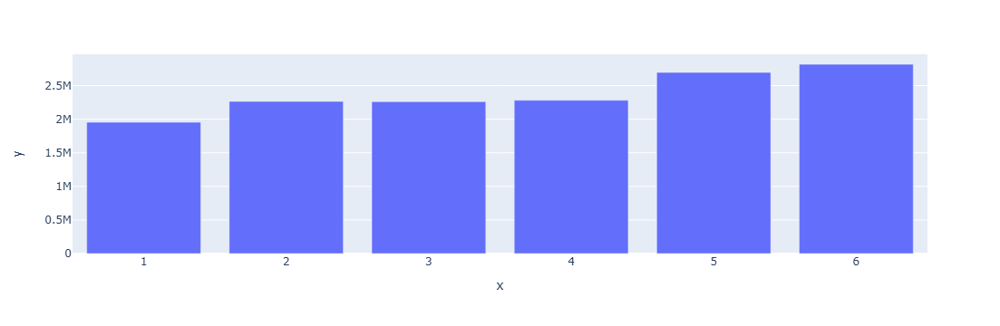

In [13]:
px.bar(x=uber_15['month'].value_counts().index,y=uber_15['month'].value_counts())

In [ ]:
sns.countplot(uber_15['hour'])

In [15]:
summary=uber_15.groupby(['weekday','hour'])['Pickup_date'].count().reset_index()
summary.head()

,weekday,hour,Pickup_date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


In [16]:
summary.columns=['weekday','hour','counts']

In [17]:
summary.head()

,weekday,hour,counts
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


<Axes: xlabel='hour', ylabel='counts'>

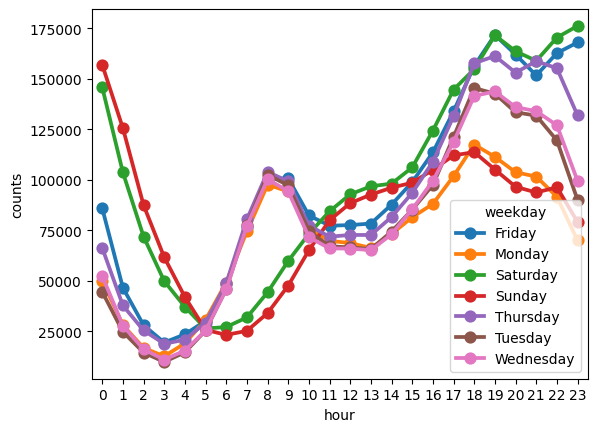

In [18]:
sns.pointplot(x='hour',y='counts',hue='weekday',data=summary)

In [20]:
uber_foil=pd.read_csv(r'C:\Users\Piyush\Desktop\oytie\Uber Analysis\Datasets/Uber-Jan-Feb-FOIL.csv')

In [21]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [23]:
uber_foil.shape

(354, 4)

In [24]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

<Axes: xlabel='dispatching_base_number', ylabel='active_vehicles'>

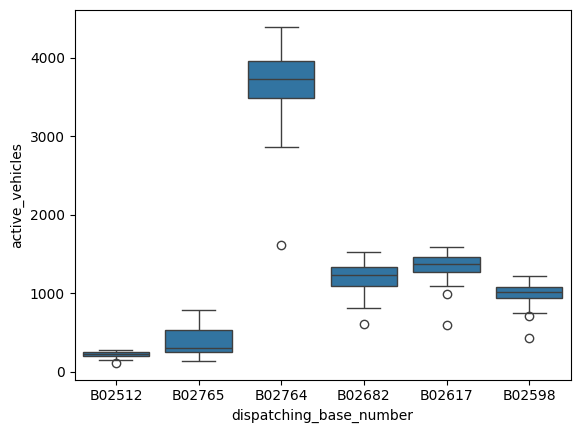

In [26]:
sns.boxplot(x='dispatching_base_number',y='active_vehicles',data=uber_foil)

<Axes: xlabel='dispatching_base_number', ylabel='trips'>

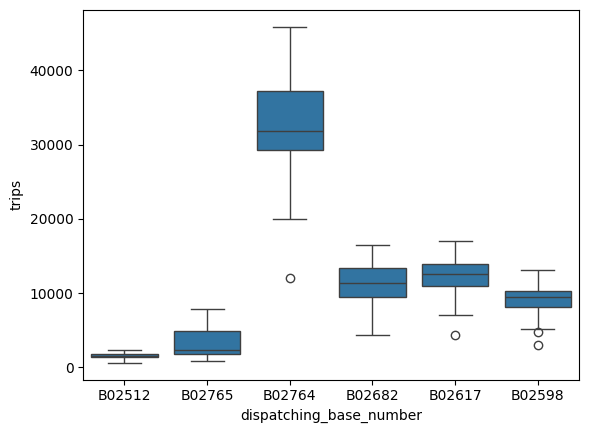

In [27]:
sns.boxplot(x='dispatching_base_number',y='trips',data=uber_foil)

In [29]:
uber_foil['trips/vehicle']=uber_foil['trips']/uber_foil['active_vehicles']

In [30]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


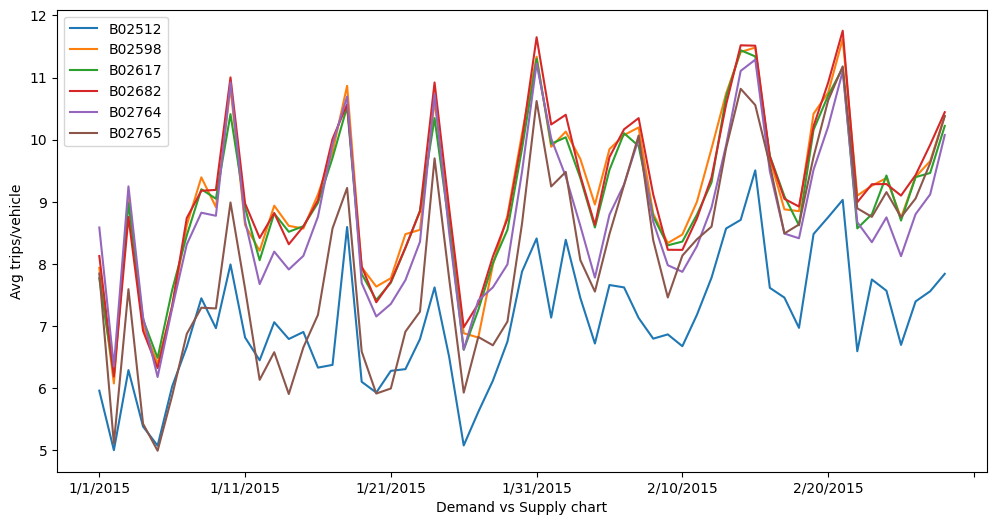

In [35]:
plt.figure(figsize=(12,6))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.ylabel('Avg trips/vehicle')
plt.xlabel('Demand vs Supply chart')
plt.legend()